# GP14 GeoPandas
GeoPandas Full Documentation: https://geopandas.org/en/stable/docs.html

Spatial Reference: https://spatialreference.org/

OSMnx Documentation: https://osmnx.readthedocs.io/en/stable/

Datashader Documentation: https://datashader.org/index.html

Colorcet Documentation: https://colorcet.holoviz.org/index.html

HoloViews Documentation: https://holoviews.org/
___
## 21. OSMNx Geospatial Data (OpenStreetMap) Retrieval
* A Python package to download, model, analyse, and visualize street networks and other geospatial features from OpenStreetMap.
* Street map visualisation can be done within Jupyter notebook with GeoPandas and Pandas. 

In [1]:
# All libraries import
import pandas as pd
import geopandas as gpd
import osmnx as ox
import folium
import matplotlib.pyplot as plt
import seaborn as sns
import geopy
from geopy.geocoders import Nominatim

### Streets

In [17]:
# Create an area of interest + Show the length of data for that area of interest
place = "Daejeon, South Korea"
graph = ox.graph_from_place(place, network_type='drive')
len(graph)

15200

In [4]:
# Conversion of data to networkx.classes allows geopandas data procession
graph

In [6]:
# Method to convert graph to geodataframe: .graph_to_gdfs()
nodes, streets = ox.graph_to_gdfs(graph)
nodes.head(3)

,y,x,street_count,ref,highway,geometry
osmid,,,,,,
274940138,36.416661,127.378284,3,NaN,NaN,POINT (127.37828 36.41666)
275898514,36.416975,127.377689,5,NaN,NaN,POINT (127.37769 36.41697)
275898563,36.411192,127.377844,3,NaN,NaN,POINT (127.37784 36.41119)


In [8]:
streets.head(3)

osmid  oneway lanes        highway maxspeed  \
u         v          key                                                    
274940138 8234413963 0    124013597    True     1  motorway_link       40   
275898514 8964537398 0    124013597    True     1  motorway_link       40   
          436793845  0     37397677   False   NaN    residential      NaN   

                         reversed   length  \
u         v          key                     
274940138 8234413963 0      False  260.691   
275898514 8964537398 0      False   17.568   
          436793845  0      False  462.029   

                                                                   geometry  \
u         v          key                                                      
274940138 8234413963 0    LINESTRING (127.37828 36.41666, 127.37915 36.4...   
275898514 8964537398 0    LINESTRING (127.37769 36.41697, 127.37781 36.4...   
          436793845  0    LINESTRING (127.37769 36.41697, 127.37764 36.4...   

                               name  ref bridge tunnel access junction  
u         v          key                                                
274940138 8234413963 0          NaN  NaN    NaN    NaN    NaN      NaN  
275898514 8964537398 0          NaN  NaN    NaN    NaN    NaN      NaN  
          436793845  0    대덕대로989번길  NaN    NaN    NaN    NaN      NaN

In [11]:
# Find the coordinates for Daejeon
locator = Nominatim(user_agent='dj1')
location = locator.geocode("Daejeon, South Korea")
print(location.address)
print("Latitude = {}, Longitude = {}".format(location.latitude, location.longitude))

대전, 대한민국
Latitude = 36.3497007, Longitude = 127.3849016


In [14]:
# Data retrieval with any tool of preference
# This example uses folium map, cartodbpositron
style = {'color':'#6f91f7', 'weight':'1'}
m = folium.Map([36.3497007, 127.3849016], zoom_start=12, tiles="cartodbpositron")
folium.GeoJson(streets, style_function=lambda x: style).add_to(m)
m
# Save and export if needed
# m.save("Daejeon1.html")

### osmnx.features module
* Retrieving features from place such as building, highway, landuse, etc.
* Other features retrival can be from address, bbox, point, polygon and xml.

In [24]:
# Retrieve the building footprints in Daejeon via .features_from_place()
buildings = ox.features_from_place(place, {'building': True})
buildings.head()

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


geometry     building  \
element_type osmid                                                 
node         1488474432  POINT (127.35494 36.36117)          yes   
             1803967193  POINT (127.42847 36.30127)          yes   
             2522963885  POINT (127.39502 36.31225)  residential   
             3009594423  POINT (127.39464 36.37733)   apartments   
             3445864128  POINT (127.31899 36.38504)   apartments   

                                         name     shelter_type addr:city  \
element_type osmid                                                         
node         1488474432  BirlZip(벌집)-by 문화가치원              NaN       NaN   
             1803967193              보문산성 장대루  weather_shelter       NaN   
             2522963885                  금호빌라              NaN       NaN   
             3009594423             스마트시티 5단지              NaN       NaN   
             3445864128               인앤인주상복합              NaN     대전광역시   

                        addr:housenumber addr:postcode addr:street access  \
element_type osmid                                                          
node         1488474432              NaN           NaN         NaN    NaN   
             1803967193              NaN           NaN         NaN    NaN   
             2522963885              NaN           NaN         NaN    NaN   
             3009594423              NaN           NaN         NaN    NaN   
             3445864128              219        305330       북유성대로    NaN   

                        building:levels  ... addr:neighborhood second_hand  \
element_type osmid                       ...                                 
node         1488474432             NaN  ...               NaN         NaN   
             1803967193             NaN  ...               NaN         NaN   
             2522963885             NaN  ...               NaN         NaN   
             3009594423             NaN  ...               NaN         NaN   
             3445864128             NaN  ...               NaN         NaN   

                        diet:meat military townhall:type community_centre  \
element_type osmid                                                          
node         1488474432       NaN      NaN           NaN              NaN   
             1803967193       NaN      NaN           NaN              NaN   
             2522963885       NaN      NaN           NaN              NaN   
             3009594423       NaN      NaN           NaN              NaN   
             3445864128       NaN      NaN           NaN              NaN   

                        fee:price type ways addr:place  
element_type osmid                                      
node         1488474432       NaN  NaN  NaN        NaN  
             1803967193       NaN  NaN  NaN        NaN  
             2522963885       NaN  NaN  NaN        NaN  
             3009594423       NaN  NaN  NaN        NaN  
             3445864128       NaN  NaN  NaN        NaN  

[5 rows x 145 columns]

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


In [25]:
# Check the number of rows and columns in the dataset
buildings.shape

(13221, 145)

In [26]:
cols = ['amenity','building', 'name', 'tourism']
buildings[cols].head()

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


amenity     building                  name tourism
element_type osmid                                                        
node         1488474432     NaN          yes  BirlZip(벌집)-by 문화가치원     NaN
             1803967193     NaN          yes              보문산성 장대루     NaN
             2522963885     NaN  residential                  금호빌라     NaN
             3009594423     NaN   apartments             스마트시티 5단지     NaN
             3445864128     NaN   apartments               인앤인주상복합     NaN

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


In [ ]:
# Shows the buildings type
list(buildings.columns)

In [ ]:
# Shows the amentities type
buildings["amenity"].apply(pd.Series)[0].value_counts()

In [128]:
# Shows only first 100 buildings listed in the dataset (Plotting all 13221 buildings would take up lots of spaces!)
style_b = {'color':'#6f91f7', 'fillColor':'#6C3483', 'weight':'1', 'fillOpacity':1}
m2 = folium.Map([36.3497007, 127.3849016], zoom_start=13, tiles="cartodbpositron")
folium.GeoJson(buildings[:100], style_function=lambda x: style_b).add_to(m2)
m2
# Save and export if needed
# m2.save("DaejeonBuildings.html")

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


## Features from place - Universities
* Retrieving features from place with tags={'amenity':'university'}

In [121]:
uni = ox.features_from_place(place, tags={'amenity':'university'})
uni.head()

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


geometry  \
element_type osmid                                                           
node         368650424                          POINT (127.40558 36.33293)   
             368650962                          POINT (127.39176 36.39967)   
             368650998                          POINT (127.37367 36.35085)   
             4810827952                         POINT (127.33758 36.32602)   
way          30659559    POLYGON ((127.45378 36.33766, 127.45416 36.337...   

                            amenity             name  \
element_type osmid                                     
node         368650424   university          을지의과대학교   
             368650962   university  한남대학교 대덕밸리캠퍼스주소   
             368650998   university            중부대학교   
             4810827952  university        목원대학교 신학관   
way          30659559    university       우송대학교 동캠퍼스   

                                                       name:en  \
element_type osmid                                               
node         368650424                   Euljiuigwa University   
             368650962        Hannam University Daedeok Campus   
             368650998                       Jungbu University   
             4810827952  Mokwon University Theology Department   
way          30659559         Woosong University (East Campus)   

                                              name:ko-Latn ncat  \
element_type osmid                                                
node         368650424                 Euljiuigwadaehakgyo  대학교   
             368650962   Hannamdaehakgyo Daedeokcaempeoseu  대학교   
             368650998                     Jungbudaehakgyo  대학교   
             4810827952                                NaN  NaN   
way          30659559                     Woosongdaehakgyo  NaN   

                                                source wikidata name:ko  \
element_type osmid                                                        
node         368650424   http://kr.open.gugi.yahoo.com  Q482658     NaN   
             368650962   http://kr.open.gugi.yahoo.com      NaN     NaN   
             368650998   http://kr.open.gugi.yahoo.com      NaN     NaN   
             4810827952                            NaN      NaN     NaN   
way          30659559                              NaN  Q625421     NaN   

                                                                     nodes  \
element_type osmid                                                           
node         368650424                                                 NaN   
             368650962                                                 NaN   
             368650998                                                 NaN   
             4810827952                                                NaN   
way          30659559    [339064227, 339064228, 339064229, 339064230, 3...   

                         ... short_name:ko phone review building  \
element_type osmid       ...                                       
node         368650424   ...           NaN   NaN    NaN      NaN   
             368650962   ...           NaN   NaN    NaN      NaN   
             368650998   ...           NaN   NaN    NaN      NaN   
             4810827952  ...           NaN   NaN    NaN      NaN   
way          30659559    ...           NaN   NaN    NaN      NaN   

                        addr:housename  fax internet_access start_date  \
element_type osmid                                                       
node         368650424             NaN  NaN             NaN        NaN   
             368650962             NaN  NaN             NaN        NaN   
             368650998             NaN  NaN             NaN        NaN   
             4810827952            NaN  NaN             NaN        NaN   
way          30659559              NaN  NaN             NaN        NaN   

                        operator operator:type  
element_type osmid                              
node         368650424    

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


In [122]:
# Number of rows and columns
uni.shape

(28, 29)

In [123]:
# Column names
uni.columns

Index(['geometry', 'amenity', 'name', 'name:en', 'name:ko-Latn', 'ncat',
       'source', 'wikidata', 'name:ko', 'nodes', 'wikipedia', 'addr:city',
       'addr:housenumber', 'addr:postcode', 'addr:street', 'website',
       'abbr_name', 'abbr_name:en', 'short_name', 'short_name:ko', 'phone',
       'review', 'building', 'addr:housename', 'fax', 'internet_access',
       'start_date', 'operator', 'operator:type'],
      dtype='object')

In [124]:
columns =['geometry', 'name', 'amenity', 'ncat']
uni[columns].head()

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


geometry  \
element_type osmid                                                           
node         368650424                          POINT (127.40558 36.33293)   
             368650962                          POINT (127.39176 36.39967)   
             368650998                          POINT (127.37367 36.35085)   
             4810827952                         POINT (127.33758 36.32602)   
way          30659559    POLYGON ((127.45378 36.33766, 127.45416 36.337...   

                                    name     amenity ncat  
element_type osmid                                         
node         368650424           을지의과대학교  university  대학교  
             368650962   한남대학교 대덕밸리캠퍼스주소  university  대학교  
             368650998             중부대학교  university  대학교  
             4810827952        목원대학교 신학관  university  NaN  
way          30659559         우송대학교 동캠퍼스  university  NaN

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


In [127]:
# Plot buildings and those universities with geometries available in geom=='Point' onto the Daejeon map
unip = uni[uni.geom_type=="Point"]
mu = folium.Map([36.3497007, 127.3849016], zoom_start=12, tiles="cartodbpositron")
# folium.GeoJson(buildings, style_function=lambda x: style_b).add_to(mu)

loc = zip(unip.geometry.y, unip.geometry.x)
for a in loc:
    folium.CircleMarker(location=a, color="brown", radius=4).add_to(mu)

mu

# Save and export if needed
# mu.save("DaejeonUni.html")

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\jupyter_client\session.py:200: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)  # noqa


___
## 22. Speeding up Geospatial Processing
* Tips to reduce the time required for processing geospatial data.
* Geofeather: a fast file-based format for geometries (points, lines, polygons) data with Geopandas.
* Datashader: a graphics pipeline system for creating meaningful representations of large datasets quickly and flexibly. Data visualisation toolchain based on aggregating into a grid. (**NOTE: NOT AVAILABLE FOR PYTHON 3.12.0 YET**)
* Colorcet: A collection of perceptually accurate 256-color colormaps for use with Python plotting programs like Bokeh, Matplotlib, HoloViews, and Datashader.
* HoloViews: An open-source Python library designed to make data analysis and visualisation seamless and simple.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
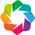

In [8]:
# Further Libraries/Modules Import
import geofeather
# import datashader as ds
# from datashader import transfer_functions as tf
from colorcet import fire
import holoviews as hv
from holoviews import opts
from holoviews.element.tiles import EsriImagery, CartoDark, OSM, StamenTerrain
# from holoviews.operation.datashader import datashade
hv.extension('bokeh')

* New York City taxi dataset. Load file: 'localdata/taxidata.shp' (**NOTE: LARGE DATASET. Loading time will require more than 3:30 mins**)
* Display the first three rows of data.

In [9]:
gdf = gpd.read_file("localdata/taxidata.shp")
gdf.head(3)

,id,vendor_id,pickup_dat,dropoff_da,passenger_,pickup_lon,pickup_lat,dropoff_lo,dropoff_la,store_and_,trip_durat,geometry
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,POINT (989193.143 219057.123)
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,POINT (989677.366 208355.623)
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,POINT (990059.955 217600.779)


In [10]:
# Check the number of rows and columns in the dataset
gdf.shape

(1458633, 12)

### Tip One: Geofeather for large files

In [11]:
# File conversion to Geofeather. Loading time requires about 25 secs
geofeather.to_geofeather(gdf,'localdata/TaxiDataGeoFeather.feather')
gf = geofeather.from_geofeather('localdata/TaxiDataGeoFeather.feather')
gf.head(3)

,id,vendor_id,pickup_dat,dropoff_da,passenger_,pickup_lon,pickup_lat,dropoff_lo,dropoff_la,store_and_,trip_durat,geometry
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,POINT (989193.143 219057.123)
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,POINT (989677.366 208355.623)
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,POINT (990059.955 217600.779)


### Tip Two: Spatial indexing for faster performance

In [12]:
# Load dataset
zones = gpd.read_file("localdata/taxizones.shp")
zones.head(3)

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((933100.918 192536.086, 933091.011 19..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((1033269.244 172126.008, 103343..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((1026308.770 256767.698, 1026495.593 ..."


<Axes: >

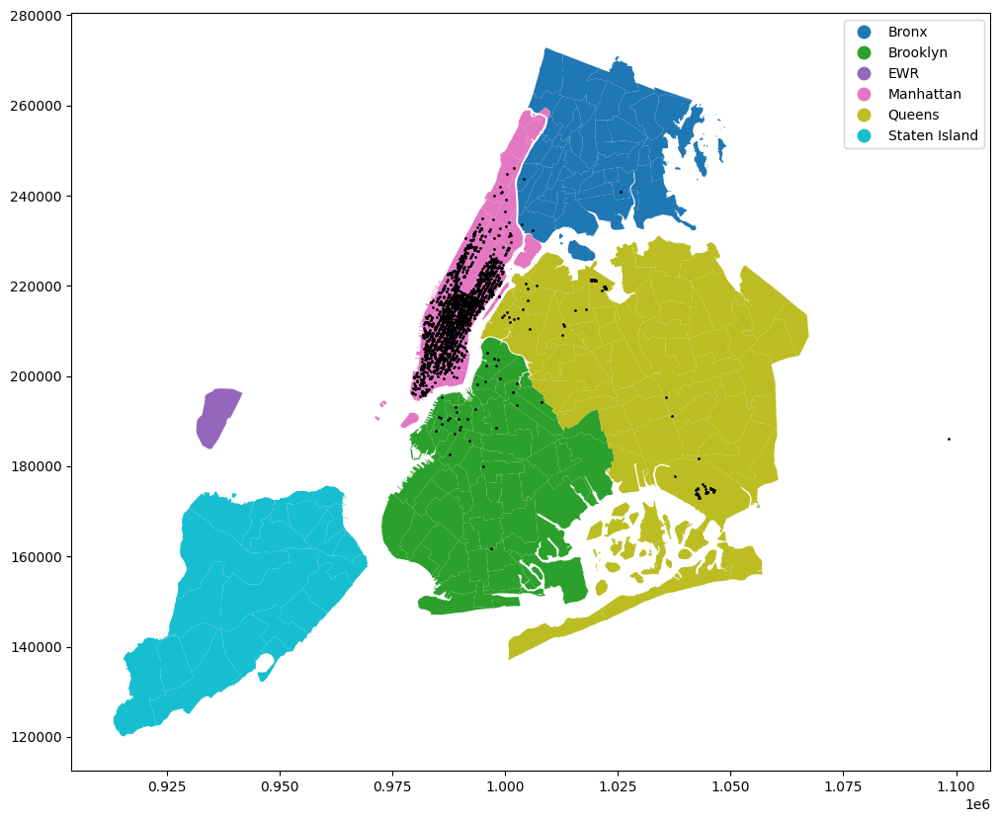

In [15]:
# Plot the first 2000 data rows
fig, ax = plt.subplots(figsize=(12,12))
zones.plot("borough", ax=ax, legend=True)
gf.sample(2000).plot(ax=ax, markersize=1, color="black")

In [16]:
# Create a data subset for Brooklyn
gfsubset = gpd.read_file("localdata/taxidata.shp", mask=zones[zones["borough"].isin(["Brooklyn"])])
gf.shape, gfsubset.shape

((1458633, 12), (26395, 12))

<Axes: >

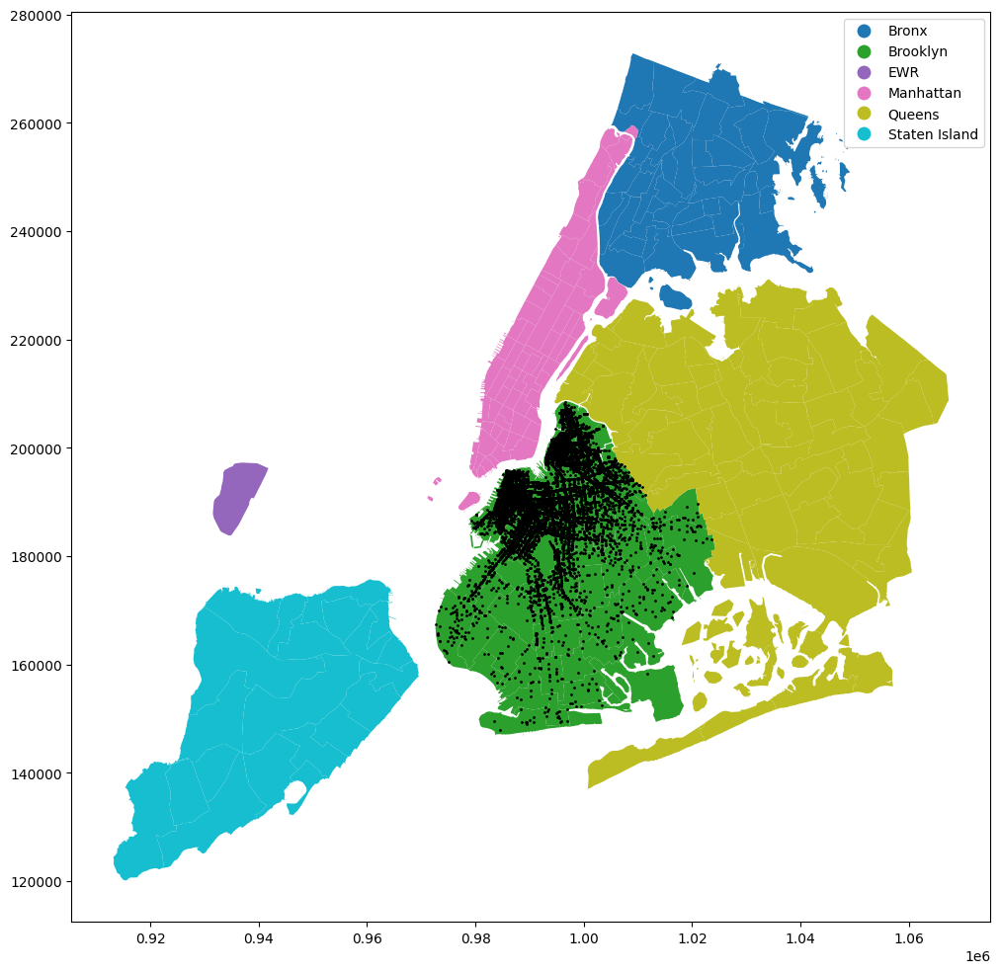

In [17]:
# Plot the data subset for Brooklyn
fig, ax = plt.subplots(figsize=(12,12))
zones.plot("borough", ax=ax, legend=True)
gfsubset.plot(ax=ax, markersize=1, color="black")

<Axes: >

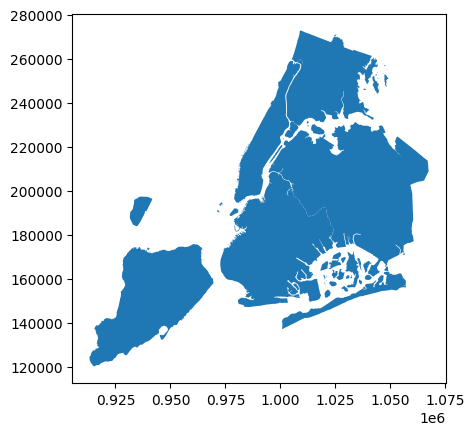

In [18]:
# Use method .dissolve() to create the separation by borough zones
bo = zones.dissolve(by='borough')
bo.plot()

In [22]:
# Non-spatial indexing: Execute a spatial join
sj1 = gpd.sjoin(gf, bo, op="within")

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [21]:
# Spatial indexing for two datasets
gfsi = gf
bosi = bo
gfsi.sindex
bosi.sindex

In [24]:
# Spatial indexing: Execute a spatial join
sj2 = gpd.sjoin(gfsi, bosi, op="within")
sj2.head(3)

C:\Users\likre\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,id,vendor_id,pickup_dat,dropoff_da,passenger_,pickup_lon,pickup_lat,dropoff_lo,dropoff_la,store_and_,trip_durat,geometry,index_right,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,POINT (989193.143 219057.123),Manhattan,4,0.043567,0.000112,Alphabet City,4
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,POINT (989677.366 208355.623),Manhattan,4,0.043567,0.000112,Alphabet City,4
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,POINT (990059.955 217600.779),Manhattan,4,0.043567,0.000112,Alphabet City,4


* Non-Spatial vs Spatial Indexing Summary: About the same efficiency when data, points and polygons have the same extent.

### Tip Three: Plotting with Datashader (UNDER CONSTRUCTION)

In [25]:
# Check the number of rows and columns for the spatial indexed joined dataset
sj2.shape

(1457523, 18)

In [26]:
# Check column names
sj2.columns

Index(['id', 'vendor_id', 'pickup_dat', 'dropoff_da', 'passenger_',
       'pickup_lon', 'pickup_lat', 'dropoff_lo', 'dropoff_la', 'store_and_',
       'trip_durat', 'geometry', 'index_right', 'OBJECTID', 'Shape_Leng',
       'Shape_Area', 'zone', 'LocationID'],
      dtype='object')

In [ ]:
# Datashader is suitable for large datasets
agg = ds.Canvas().points(sj2, 'pickup_lon', 'pickup_lat')
img = tf.set_background(tf.shade(agg, cmap=fire),"black")
img

In [ ]:
df = sjoined[['dropoff_lo', 'dropoff_la', 'passenger_']]

import holoviews as hv
from holoviews.element.tiles import EsriImagery, CartoLight, CartoDark, EsriUSATopo, StamenLabels
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

map_tiles = StamenLabels().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(df, ['dropoff_lo', 'dropoff_la'])
taxi_trips = datashade(points, x_sampling=0.0001, y_sampling=0.0001, cmap=fire, width=900, height=480)

map_tiles*taxi_trips

___